## Chapter 13: Multi-layer Perceptrons 

# 13.2 Batch normalization

Previously when dealing with linear supervised learning (see e.g., Sections 8.4, 9.4, 10.3, and 11.3) we saw how normalizing each input feature of a dataset significantly aids in parameter tuning by improving the shape of a cost function's contours (making them more 'circular').  Another way of saying this is that we normalized *every distribution that touches a system parameter* - which in the linear case consists of the distribution of each input feature.   The intuition that normalizing parameter touching distributions carries over completely from the linear learning scenario to our current situation - where we are conducting nonlinear learning via multilayer perceptrons.  The difference here is that now we have many more parameters (in comparison to the linear case) and many of these parameters are *internal* as opposed to weights in a linear combination.  Nonetheless each parameter - as we detail here - touches a distribution that when normalized tends to improve optimization speed.  

Specifically - as we will investigate here in the context of the multilayer perceptron - to completely carry over the idea of input normalization to our current scenario we will need to normalize the output of each and every network activation.  Moreover since these activation distributions naturally change whenever during parameter tuning - e.g., whenever a gradient descent step is made - we must normalize these internal distributions every time we make a parameter update.  This leads to the incorporation of a normalization step grafted directly onto the architecture of the multilayer perceptron itself - which is called every time weights are changed.  This natural extension of input normalization is popularly referred to as *batch normalization*.

In [ ]:
# This code cell will not be shown in the HTML version of this notebook
# import various basic libraries
import copy
import pickle
import matplotlib.pyplot as plt
import sys
sys.path.append('../../')

# import autograd functionality
import autograd.numpy as np

# imports from custom library
from mlrefined_libraries import nonlinear_superlearn_library as nonlib
from mlrefined_libraries import superlearn_library as superlearn

datapath = '../../mlrefined_datasets/nonlinear_superlearn_datasets/'
regress_plotter = nonlib.nonlinear_regression_demos
feature_plotter = nonlib.perceptron_scaling_tools
classification_plotter = superlearn.classification_static_plotter.Visualizer();

# this is needed to compensate for %matplotl+ib notebook's tendancy to blow up images when plotted inline
from matplotlib import rcParams
rcParams['figure.autolayout'] = True
%matplotlib notebook

%load_ext autoreload
%autoreload 2

## 13.2.1  The stable weight touching distributions of a linear model

When discussing linear model based learning in Chapters 8 - 11 we employed the generic linear model

\begin{equation}
\text{model}\left(\mathbf{x},\mathbf{w}\right) = w_0 + x_1w_1 + \cdots  + x_Nw_N
\end{equation}

for both regression and classification.   When tuning these weights via the minimization of any cost function over a dataset of $P$ points $\left\{\mathbf{x}_p,y_p\right\}_{p=1}^P$ we can see how the $n^{th}$ dimension of each input point $x_{p,n}$ touches the $n^{th}$ weight $w_n$.  Because of this, as we discussed previously, the input distribution along the $n^{th}$ dimension $\left\{x_{p,n} \right\}_{p=1}^P$ touching $w_n$ strongly affects the contours of any cost function along the $w_n$ direction.  If these input distributions differ, as is typically the case in practice, the contours of a cost function stretch out in long directions making optimization via gradient descent quite challenging irregardless of the choice of steplength.  However by normalizing each input dimensions via the standard normalization scheme - i.e., by mean centering and re-scaling by its standard deviation (see Sections 8.4, 9.4, and 10.3) - we can subtantially temper the contours of a cost funtion making it much easier to optimize.  

Performing standard normalization along the $n^{th}$ input feature means making the replacement

\begin{equation}
x_{p,n}  \longleftarrow \frac{x_{p,n}  - \mu_{n}}{\sigma_{n}}
\end{equation}

where $\mu_n$ and $\sigma_n$ are the mean and standard deviation along the $n^{th}$ feature of the input, respectively.  Performing standard normalization on the input of a linear model helps temper any cost function along each parameter direction $w_1,\,w_2,\,...,w_N$.  Of course once normalized these input distributions $\left\{x_{p,n} \right\}_{p=1}^P$ for each $n$ never change again - they remain stable regardless of how we set the parameters of our model / during training.

## 13.2.2 Batch normalized single layer perceptron units

Now let us think about our current context, where we are in general employing a linear combination of $B$ multilayer perceptron feature transformations in a nonlinear `model` that takes the general form

\begin{equation}
\text{model}\left(\mathbf{x},\mathbf{w}\right) = w_0 + f_1\left(\mathbf{x}\right)w_1 + \cdots + f_B\left(\mathbf{x}\right)w_B
\end{equation}

where note here the variable $\mathbf{w}$ on the left hand side denotes all parameters of the model (the weights of the linear combination $w_0$,...,$w_B$) as well as those internal to each nonlinear feature transformation $f_1$,...,$f_B$.  As we can see by studying simple examples, here *standard normalization of the input only tempers the contours of a cost function along the weights internal to the first layer of a multilayer perceptron only*, as these are the weights touched by the distribution of each input dimension.

For example let us look at the simplest case (of a multilayer perceptron) and suppose each feature transformation of our model is a single hidden layer perceptron, the $b^{th}$ of which takes the general form (as introduced in the previous Section)

\begin{equation}
f^{(1)}_b\left(\mathbf{x}\right)=a\left(w^{\left(1\right)}_{0,\,b}+\underset{n=1}{\overset{N}{\sum}}{w^{\left(1\right)}_{n,\,b}\,x_n}\right)
\end{equation}

where $a\left(\cdot\right)$ is an *activation function*.  Hence this means that our `model` takes the form 

\begin{equation}
\text{model}\left(\mathbf{x},\mathbf{w}\right) = w_0 + f^{(1)}_1\left(\mathbf{x}\right)w_1 + \cdots + f^{(1)}_B\left(\mathbf{x}\right)w_B.
\end{equation}

In this instance we can see that the data input does not touch weights of the linear combination $w_1,\,w_2,...,w_B$ (as was the case with our linear model), but touches the *internal* weights of each perceptron  i.e., the $n^{th}$ input feature dimension touches the internal weights $w_{b,n}$ for $b=1,...,B$.  So in other words, by performing standard normalization on the input here we temper the contours of a cost function along the *internal* weights of a model employing single hidden layer elements.  

But what about the contours of the cost function along the weights of the linear combination $w_1,\,w_2,...,w_B$?  Which data distributions touch them?  A simple glance at our `model` above and we can see that it is the distribution of *each perceptron / activation output over the input data*.  In other words, the distribution  $\left\{f^{(1)}_b\left(\mathbf{x}_p\right) \right\}_{p=1}^P$ touches the weight $w_b$ of the linear combiination.  Now if we know that the distribution touching the weight of a model affects any cost function along this dimension, then we in complete analogy to how we have normalized the input data we should in this case perform standard normalization on each of these activation output distributions.  To do this we normalize each activation output by mean centering and re-scaling by its corresponding standard deviation as

\begin{equation}
f_b^{(1)} \left(\mathbf{x}_p \right) \longleftarrow \frac{f_b^{(1)} \left(\mathbf{x}_p\right) - \mu_{f_b^{(1)}}}{\sigma_{f_b^{(1)}}}
\end{equation}

where

\begin{array}
\
\mu_{f_b^{(1)}} = \frac{1}{P}\sum_{p=1}^{P}f_b^{(1)}\left(\mathbf{x}_p \right) \\
\sigma_{f_b^{(1)}} = \sqrt{\frac{1}{P}\sum_{p=1}^{P}\left(f_b^{(1)}\left(\mathbf{x}_p \right) - \mu_{f_b^{(1)}} \right)^2}.
\end{array}

However it is important to note that - unlike the distribution of the input data - the distribution of each of these activation outputs can shift *every time the internal parameters of our system are changed*.  In other words, since each of the functions $f^{(1)}_b$ has *internal parameters* the distribution $\left\{f^{(1)}_b\left(\mathbf{x}_p\right) \right\}_{p=1}^P$ varies depending on the setting of these internal weights (as we will illustrate via examples below).  In the jargon of deep learning this is often referred to as *internal covariate shift* or just *covariate shift* for short.

Since the weights of our model will change during optimization - e.g., from one step of gradient descent to the next - in order to keep the activation output distributions normalized we must normalize them *at every step of parameter tuning (e.g., via gradient descent)*.   To do this we can simply build in a *standard normalization* step directly into the perceptron architecture itself, as we show in the `Python` implementation in Section 13.2.4 below.

> The distribution of activation outputs in a single layer network $\left\{f^{(1)}_b\left(\mathbf{x}_p\right) \right\}_{p=1}^P$ changes depending on the setting of the units' internal parameters, a problem called *covariate shift* in the jargon of deep learning.  This means that - in order to temper these distributions - we must normalize them every time weights are updated (like e.g., at each step of gradient descent).  This can be easily done by inserting a normalization step into the recursive algorithm for constructing perceptron units.

We can easily adjust the generic recipe for building single layer basis functions introduced in the previous Section to include this standard normalization step.  To contruct a *batch normalized* single layer perceptron function $f^{(1)}\left(\mathbf{x}\right)$  we follow the three step recipe

### Recursive rescipe for batch normalized single layer units

<hr style="height:1px;border:none;color:#555;background-color:#555;">
<p style="line-height: 1.7;">
<strong>1:</strong>&nbsp;&nbsp; <strong>input:</strong> Activation function $a\left(\cdot\right)$ and dataset $\left\{\mathbf{x}_p \right\}_{p=1}^P$

<br>

<strong>2:</strong>&nbsp;&nbsp; Compute linear combination of the input: $w_{0}+{\sum_{n=1}^{N}}{w_{n}\,x_n}$ <br>

<strong>3:</strong>&nbsp;&nbsp; Pass result through nonlinear activation: $f^{(1)}\left(\mathbf{x}\right) = a\left(w_{0}+{\sum_{n=1}^{N}}{w_{n}\,x_n}\right)$ <br>


<strong>4:</strong>&nbsp;&nbsp; Compute mean

$\mu_{f^{(1)}} = \frac{1}{P}\sum_{p=1}^{P}f^{(1)}\left(\mathbf{x}_p \right)$ and standard deviation
$\sigma_{f^{(1)}} = \sqrt{\frac{1}{P}\sum_{p=1}^{P}\left(f^{(1)}\left(\mathbf{x}_p \right) - \mu_{f^{(1)}} \right)^2}$.<br>

<strong>5:</strong>&nbsp;&nbsp;
Standard normalize unit: $f^{(1)} \left(\mathbf{x} \right) \longleftarrow \frac{f^{(1)} \left(\mathbf{x}\right) - \mu_{f^{(1)}}}{\sigma_{f^{(1)}}}$ 
<br>

<strong>6:</strong>&nbsp;&nbsp; <strong>output:</strong> Batch normalized single layer unit $f^{(1)}$<br/>

<hr style="height:1px;border:none;color:#555;background-color:#555;">
</p>

## 13.2.3  Batch normalized multilayer perceptron units

If we employ a sum of $L$ layer multilayer functions with our `model`


\begin{equation}
\text{model}\left(\mathbf{x},\mathbf{w}\right) = w_0 + f^{(L)}_1\left(\mathbf{x}\right)w_1 + \cdots + f^{(L)}_B\left(\mathbf{x}\right)w_B
\end{equation}

and we pick apart how each one is constructed recursively (as detailed in the previous Section) we can see that *the distribution of activation outputs from every layer of the network touches a model weight*.  By the same logic we came to in developing our normalization procedures - that it is always beneficial to normalize any distribution touching a model weight - along with our discussion above with the single layer case, it then makes sense in the case of a multilayer perceptron to *normalize the distribution of every layer's activation output*. 

For example, following our recursive recipe we can write a two layer perceptron unit *algebraically* in general as

\begin{equation}
f_b^{\left(2\right)}\left(\mathbf{x}\right)=a\left(w^{\left(2\right)}_{0,b}+\underset{i=1}{\overset{U_1}{\sum}}{w^{\left(2\right)}_{i,b}}\,f^{(1)}_i\left(\mathbf{x}\right) \right)
\end{equation}

where each single unit element is defined

\begin{equation}
f^{(1)}_i\left(\mathbf{x}\right) = a\left(w^{\left(1\right)}_{0,i}+\underset{n=1}{\overset{N}{\sum}}{w^{\left(1\right)}_{n,i}\,x_n}\right).
\end{equation}

In analogy to what we have seen so far - what quantities should be normalized here to help condition the contours of a cost function along particular weight directions?  Answer: any distribution touching a weight.  Here this includes 

- the input distribution of the data $x_n$ along the $n^{th}$ dimension for each fixed value of $n$, since each such distribution touches the first layer weight $w^{\left(1\right)}_{n,i}$


- the first layer activation output distribution $\left\{f^{(1)}_i\left(\mathbf{x}_p\right) \right\}_{p=1}^P$ for each fixed value of $i$, since each such distribution touches the second layer weight $w^{\left(2\right)}_{i,b}$





- the second layer activation output distribution $\left\{f^{(2)}\left(\mathbf{x}_p\right) \right\}_{p=1}^P$, since each such distribution touches a weight $w_b$ of the linear combination

This same pattern idea for deeper networks as well - if we want a cost function to be easier to optimize when using a set of deep network features we want to make sure each and every weight-touching distribution is normalized.  This set of distributions is comprise of each dimension of the input and every activation output. 

> If we want a cost function to be easier to optimize when using a set of deep network features we want to make sure each and every weight-touching distribution is normalized.  This set of distributions is comprise of each dimension of the input and every activation output.

 Doing this using the standard normalization procedure is referred to as *batch normalizing* a multilayer perceptron.  With such a simple adjustment we can still construct each *batch normalized* perceptron unit recursively, since all we must do is insert a standard normalization step into the end of each layer as summarized below. 

### Recursive rescipe for batch normalized multilayer layer units

<hr style="height:1px;border:none;color:#555;background-color:#555;">
<p style="line-height: 1.7;">
<strong>1:</strong>&nbsp;&nbsp; <strong>input:</strong> Activation function $a\left(\cdot\right)$, dataset $\left\{\mathbf{x}_p \right\}_{p=1}^P$, and number of units per layer $U_1,\,U_2,...,U_{L-1}$

<br>

<strong>2:</strong>&nbsp;&nbsp; Construct batch normalized $L-1$ layer units $f^{(L-1)}_j\left(\mathbf{x}\right)$ for $j=1,\,...,U_{L-1}$ <br>

<strong>3:</strong>&nbsp;&nbsp; 
Compute linear combination: $w_{0}+{\sum_{j=1}^{U_{L-1}}}{w_{j}\,f^{(L-1)}_j}\left(\mathbf{x}\right)$  <br>

<strong>4:</strong>&nbsp;&nbsp; Pass result through nonlinear activation: $f^{(L)}\left(\mathbf{x}\right) = a\left(w_{0}+{\sum_{j=1}^{U_{L-1}}}{w_{j}\,f^{(L-1)}_j}\left(\mathbf{x}\right)\right)$   <br>


<strong>5:</strong>&nbsp;&nbsp; Compute mean

$\mu_{f^{(L)}} = \frac{1}{P}\sum_{p=1}^{P}f^{(L)}\left(\mathbf{x}_p \right)$ and standard deviation
$\sigma_{f^{(L)}} = \sqrt{\frac{1}{P}\sum_{p=1}^{P}\left(f^{(L)}\left(\mathbf{x}_p \right) - \mu_{f^{(L)}} \right)^2}$.<br>

<strong>6:</strong>&nbsp;&nbsp;
Standard normalize unit: $f^{(L)} \left(\mathbf{x} \right) \longleftarrow \frac{f^{(L)} \left(\mathbf{x}\right) - \mu_{f^{(L)}}}{\sigma_{f^{(L)}}}$ 
<br>

<strong>7:</strong>&nbsp;&nbsp; <strong>output:</strong> Batch normalized $L$ layer unit $f^{(L)}$<br/>

<hr style="height:1px;border:none;color:#555;background-color:#555;">
</p>

## 13.2.4  A  `Python` implementation of batch normalization

Below we illustrate how one can implement the activation output normalization idea unwravelled above.  First we provide the same `Python` implementation for our original multilayer perceptron `feaeture_transforms` described in the previous Section.  We also define a `relu` activation function for testing (which we do below).

In [326]:
# relu activation
def activation(t):
    return np.maximum(0,t)

In [306]:
# fully evaluate our network features using the tensor of weights in w
def feature_transforms(a, w):    
    # loop through each layer matrix
    for W in w:
        #  pad with ones (to compactly take care of bias) for next layer computation        
        o = np.ones((1,np.shape(a)[1]))
        a = np.vstack((o,a))
        
        # compute linear combination of current layer units
        a = np.dot(a.T, W).T
    
        # pass through activation
        a = activation(a)
    return a

To standard normalize the activation outputs we simply need to add a few lines to the end of the `for` loop that subtracts off the mean of `a` along each of its inputs and divides off their associated standard deviations (provided they are non-zero).  We have already developed a simple module for performing this computation in Section 8.4, and give a short version of the `standard_normaliizer` function below.  This function takes in a set of input `x` and returns a `Python` function that normalizes any desired input centering / scaling according to the mean and standard deviation of `x`.

In [307]:
# standard normalization function 
def standard_normalizer(x):
    # compute the mean and standard deviation of the input
    x_means = np.mean(x,axis = 1)[:,np.newaxis]
    x_stds = np.std(x,axis = 1)[:,np.newaxis]   

    # check to make sure thta x_stds > small threshold, for those not
    # divide by 1 instead of original standard deviation
    ind = np.argwhere(x_stds < 10**(-2))
    if len(ind) > 0:
        ind = [v[0] for v in ind]
        adjust = np.zeros((x_stds.shape))
        adjust[ind] = 1.0
        x_stds += adjust

    # create standard normalizer function
    normalizer = lambda data: (data - x_means)/x_stds

    # return normalizer 
    return normalizer

We then employ this code in our multilayer perceptron, which we call `feature_transforms_normalized` to distinguish it from the code block above.  Here we can see that the standard normalizer is created based on the activation output of a single layer of the network in line 17 and is then used to actually perform this normalization in line 18. 

In [308]:
# a multilayer perceptron network, note the input w is a tensor of weights, with 
# activation output normalization
def feature_transforms_batch_normalized(a, w):    
    # loop through each layer matrix
    for W in w:
        #  pad with ones (to compactly take care of bias) for next layer computation        
        o = np.ones((1,np.shape(a)[1]))
        a = np.vstack((o,a))
        
        # compute linear combination of current layer units
        a = np.dot(a.T, W).T
    
        # pass through activation
        a = activation(a)
        
        # NEW - perform standard normalization to the activation outputs
        normalizer = standard_normalizer(a)
        a = normalizer(a)
    return a

## 13.2.5  Examples illustrating covariate shift and the benefit of batch normalization

In this short Subsection we use the `Python` implementation of a batch normalized multilayer perceptron given above to perform a few simple experiments that illustrate both the problem of *internal covariate shift*, that is the shifting distributions of activation outputs at each layer of a multilayer perceptron, as well as the general benefit (in terms of optimization speed-up) of batch normalization.

#### <span style="color:#a50e3e;">Example 1. </span>  The shifting distributions / internal covariate shift of a single layer perceptron

In this example we illustrate the *covariate shift* of a single layer perceptron with two `relu` units $f^{(1)}_1$ and $ f^{(1)}_2$

\begin{equation}
\text{model}\left(\mathbf{x},\mathbf{w}\right) = w_0 + f^{(1)}_1\left(\mathbf{x}\right)w_1 + f^{(1)}_2\left(\mathbf{x}\right)w_2
\end{equation}

employing the two-class classification dataset shown below.  

<IPython.core.display.Javascript object>


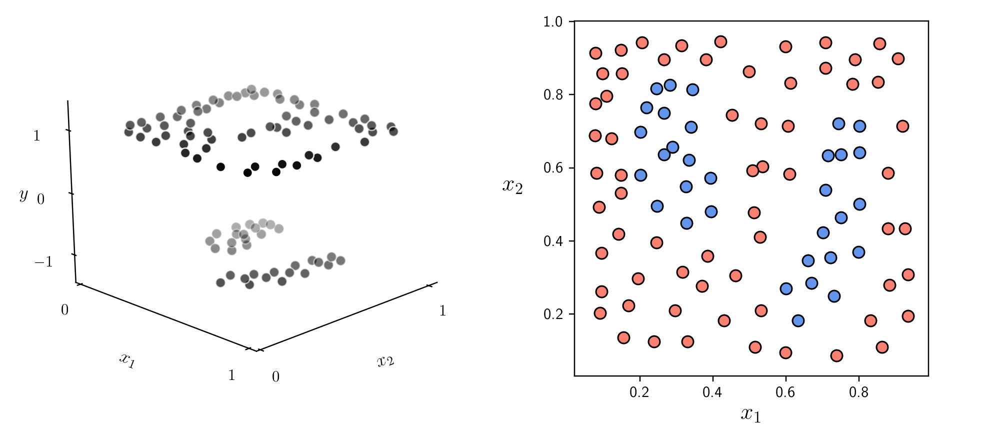

In [309]:
# This code cell will not be shown in the HTML version of this notebook
# load in toy classification dataset
viewer = nonlib.nonlinear_classification_visualizer.Visualizer(datapath + '2eggs_data.csv')
x = viewer.x.T
y = viewer.y[np.newaxis,:]

# plot toy classification data
viewer.plot_data()

We now run $10,000$ steps of gradient descent to minimize the softmax cost using this single layer network, where we standard normalize the input data.  We use a set of random weights for the network loaded in from memory.

In [310]:
# This code cell will not be shown in the HTML version of this notebook
# load in a set of random weights from memory
w = pickle.load( open(datapath +"13_2_single_layer_weights.p", "rb" ) )

# run gradient descent to minimize a single layer perceptron model
alpha_choice = 10**(-1); max_its = 5000;
run1 = nonlib.basic_runner.Setup(x,y,feature_transforms,'softmax',normalize = 'standard')
run1.fit(w=w,alpha_choice = alpha_choice,max_its=max_its)

Below we show an animation of this gradient descent run, plotting the distribution of activation outputs $\left\{f^{(1)}_1\left(\mathbf{x}_p\right),\,f^{(1)}_2\left(\mathbf{x}_p\right)  \right\}_{p=1}^P$ at a subset of the steps taken during the run.  In the left panel we show this *covariate shift* or activation output distribution at the $k^{th}$ step of the optimization, while the right panel shows the complete cost function history curve where the current step of the animated optimization is marked on the curve with a red dot.  Moving the slider from left to right progresses the run from start to finish.


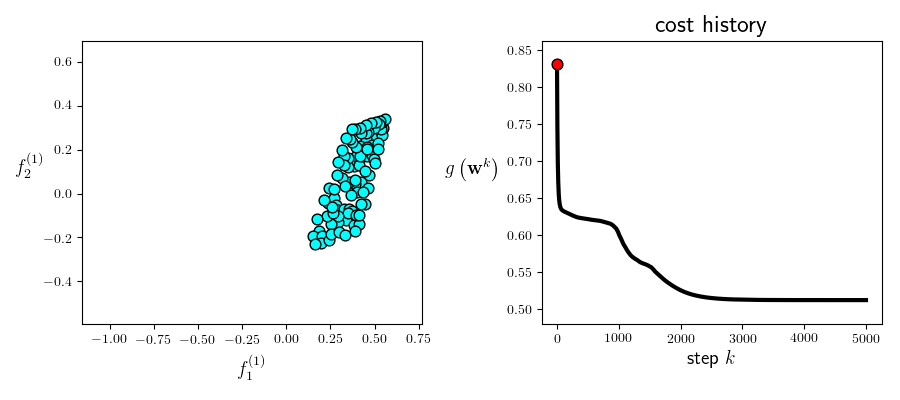
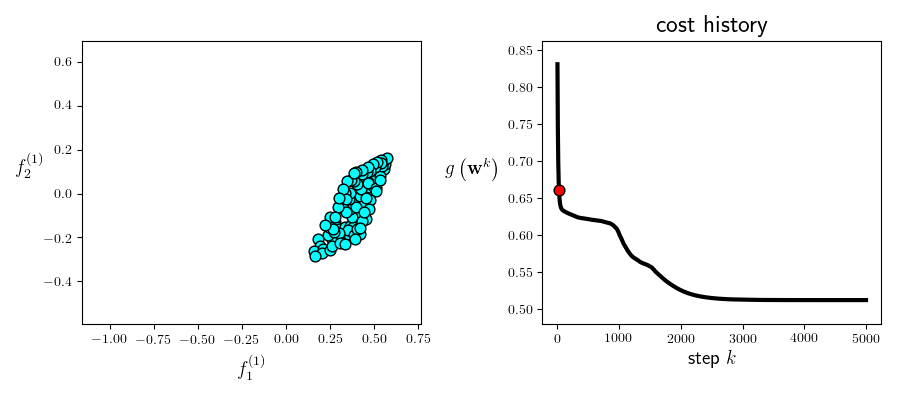
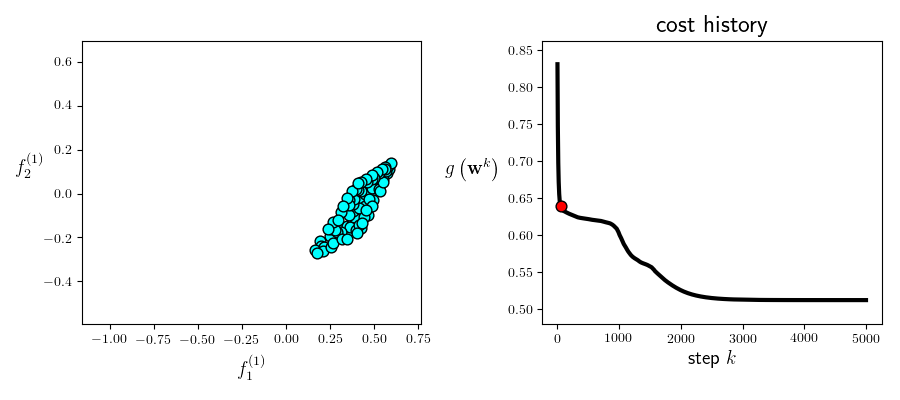
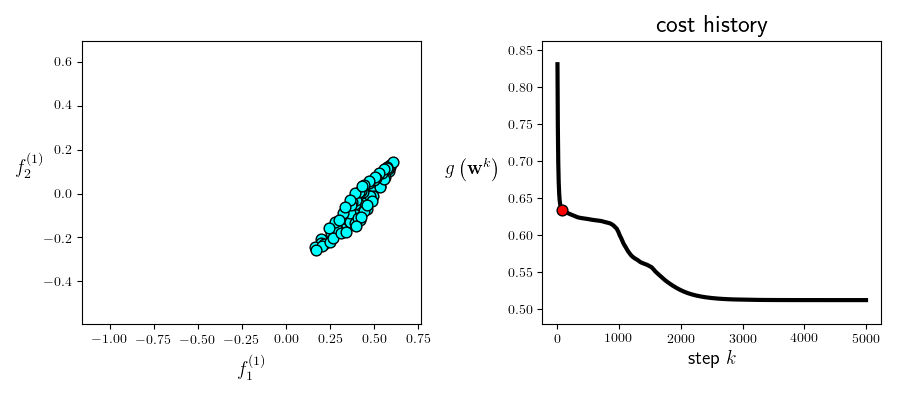
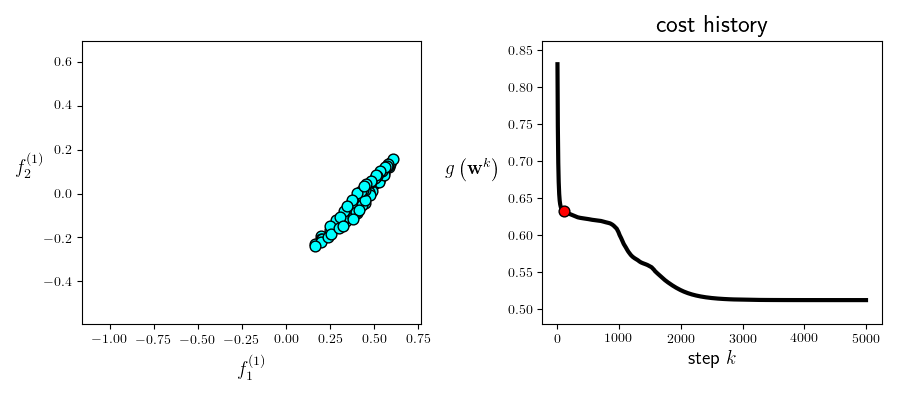
...
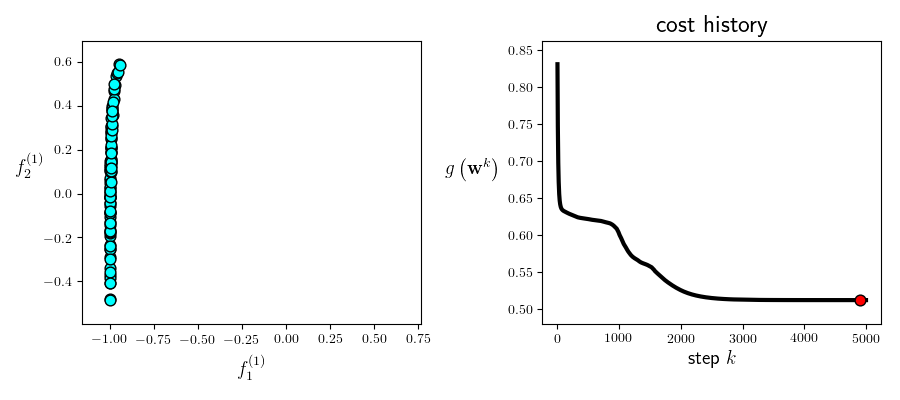
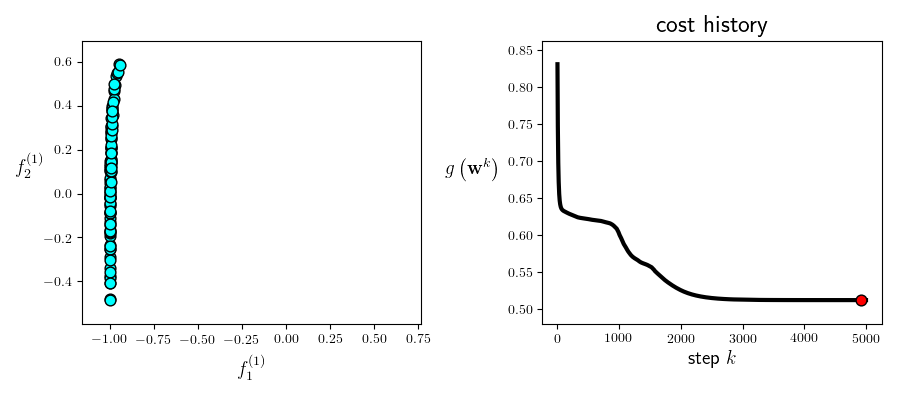
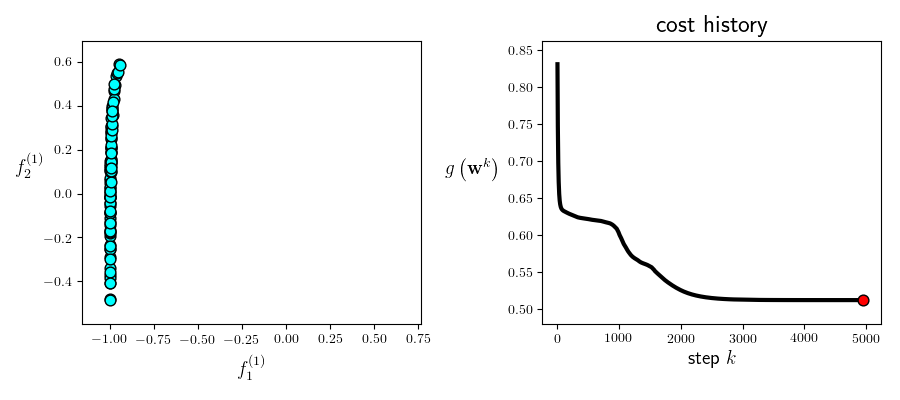
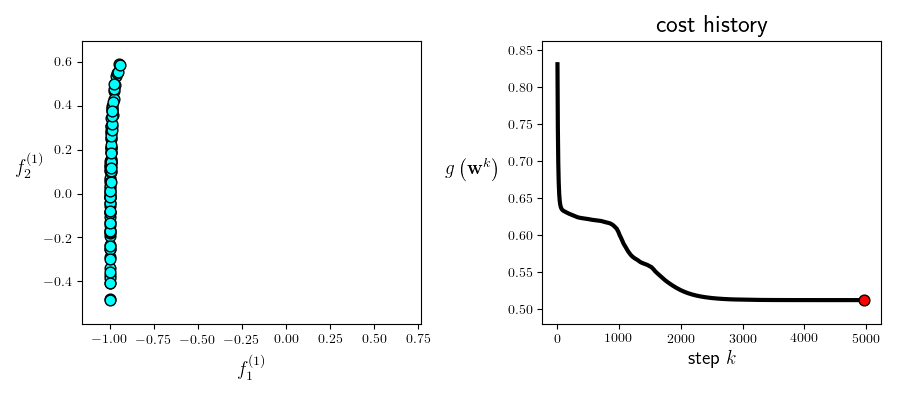
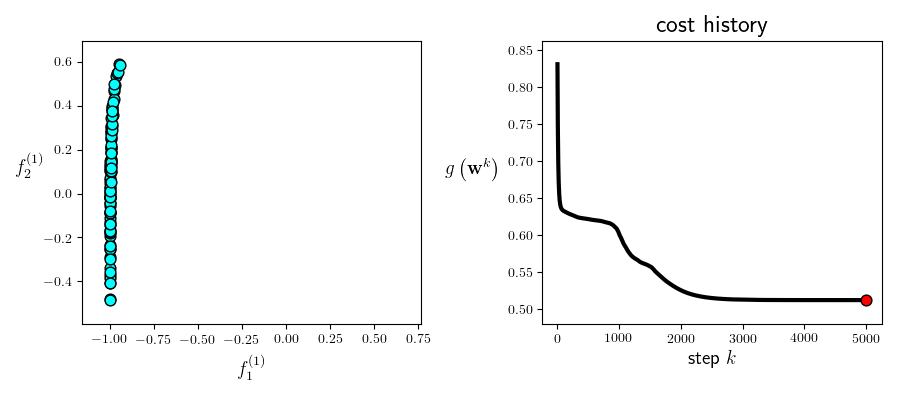

In [311]:
# This code cell will not be shown in the HTML version of this notebook
# show a plot of the distribution of activation outputs of a single layer perceptron
frames = 200
demo1 = feature_plotter.Visualizer()
demo1.shifting_distribution(run1,frames,x,show_history = True)

As you can see by moving the slider around, the distribution of activation outputs - i.e., the distributions touching the weights of our `model`'s linear combination $w_0$ and $w_1$ - change dramatically as the gradient descent algorithm progresses.  We can intuit (from our previous discussions on input normalization) that this sort of shifting distribution negatively effects the speed at which gradient descent can properly minimize our cost function.

Now we repeat the above experiment using the batch normalized single layer perceptron - making a run of $10,000$ gradient descent steps using the same initialization used above.  We then animate the covariate shift / distribution of activation outputs using the same animation tool used above as well.  Moving the slider below from left to right - progressing the algorithm - we can see here that the distribution of activation outputs stays considerably more stable. 


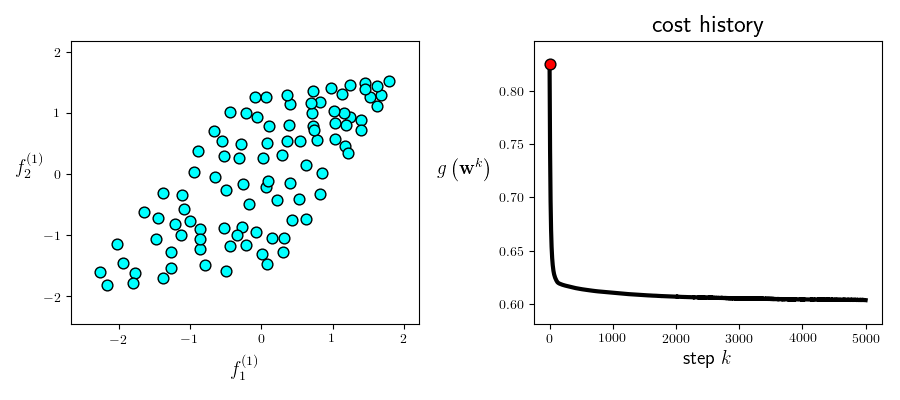
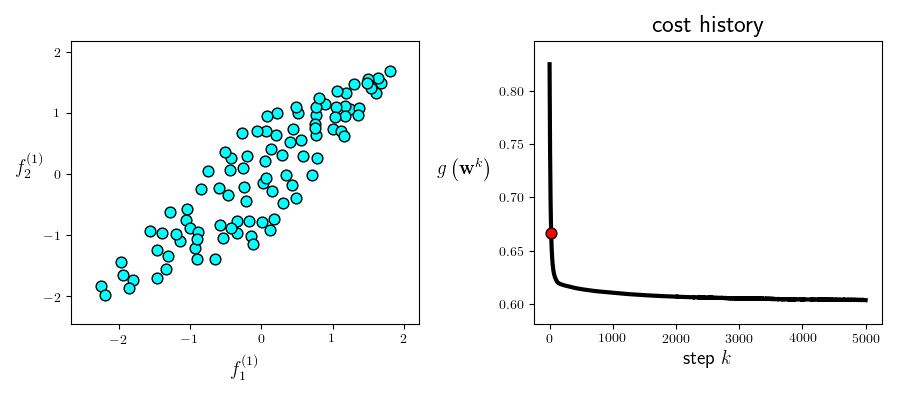
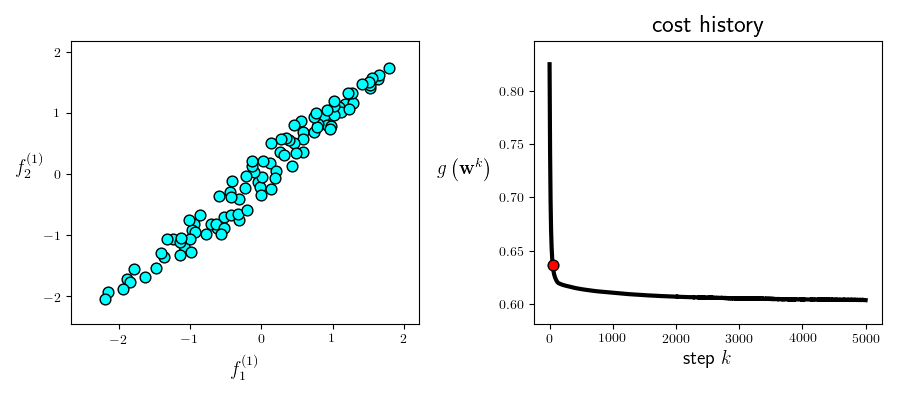
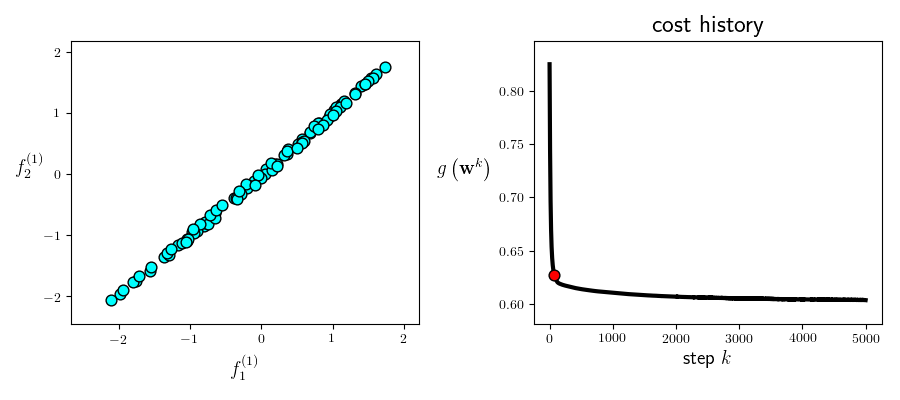
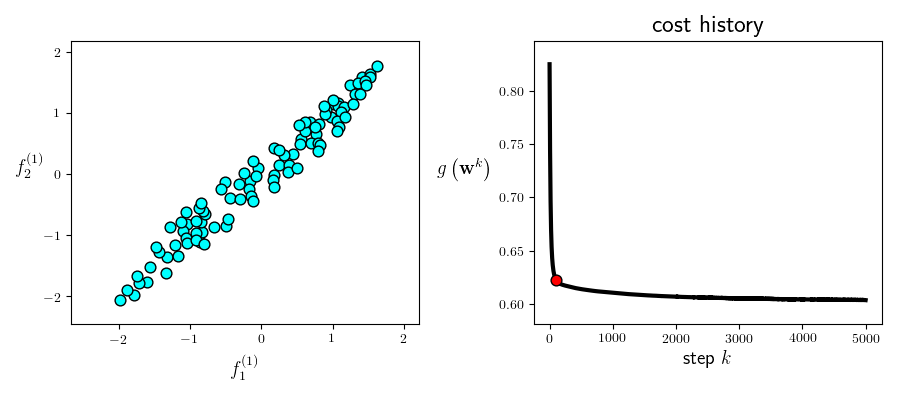
...
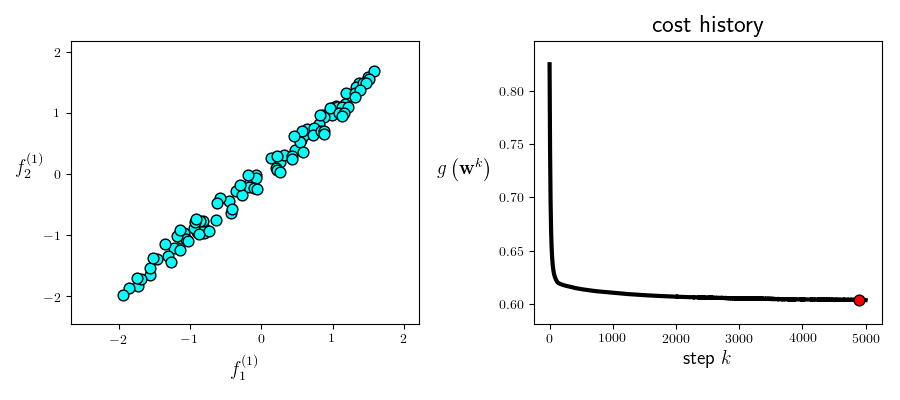
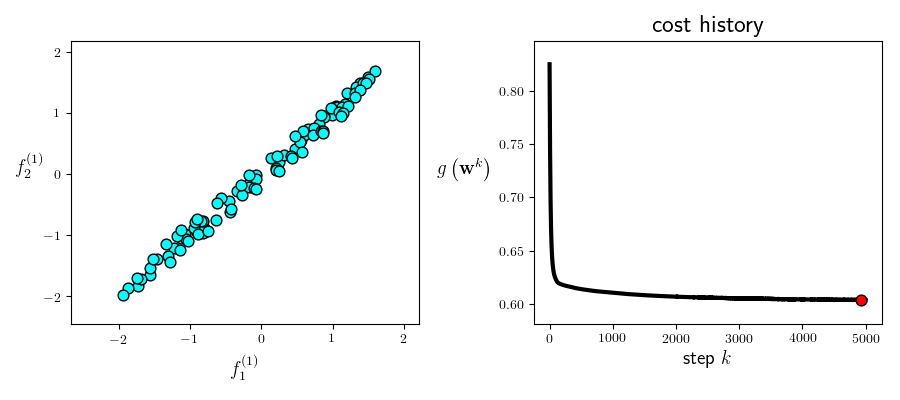
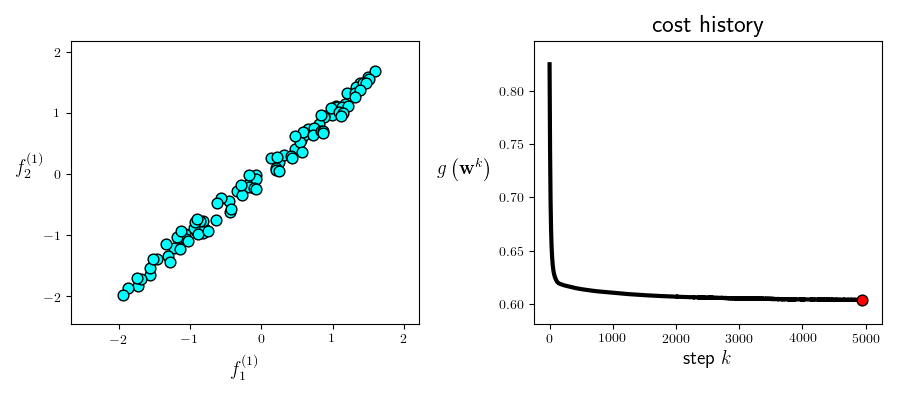
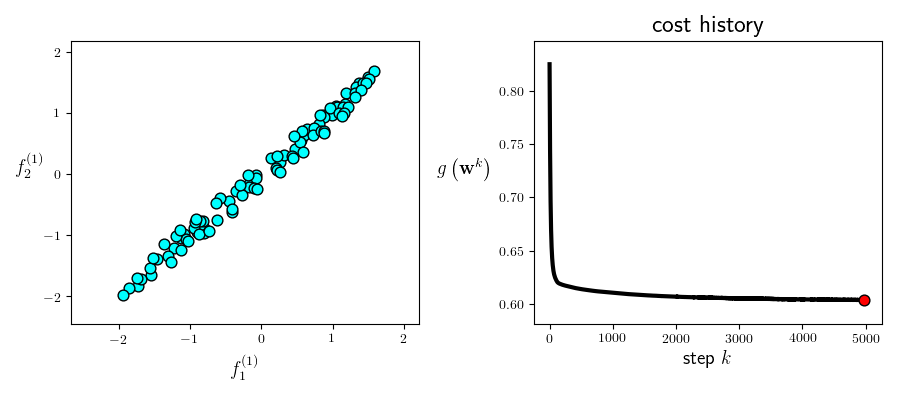
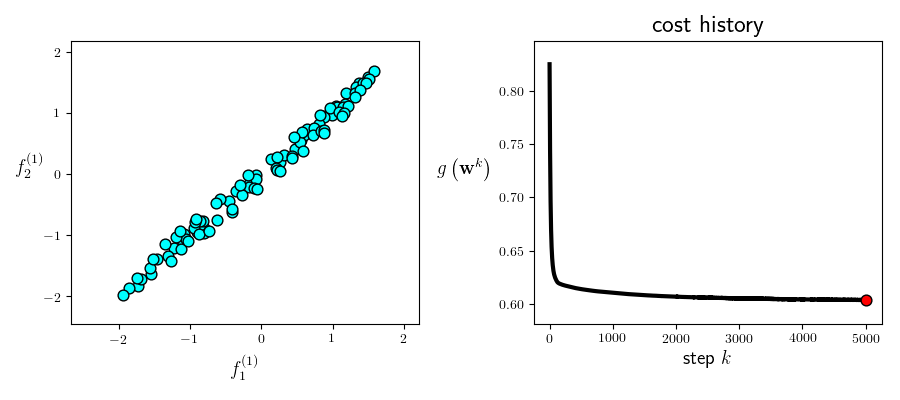

In [312]:
# This code cell will not be shown in the HTML version of this notebook
# run gradient descent to minimize a batch normalized single layer perceptron model
alpha_choice = 10**(-1); max_its = 5000;
run2 = nonlib.basic_runner.Setup(x,y,feature_transforms_batch_normalized,'softmax',normalize = 'standard')
run2.fit(w=w,alpha_choice = alpha_choice,max_its=max_its)

# show a plot of the distribution of each feature
frames = 200
demo2 = feature_plotter.Visualizer()
demo2.shifting_distribution(run2,frames,x,show_history = True,normalize = True)

#### <span style="color:#a50e3e;">Example 2. </span>  The shifting distributions / covariate shift of a multilayer perceptron

In this example we illustrate the covariate shift of a standard $4$ layer multilayer perceptron with two units per layer, using the `relu` activation and the same dataset employed in the previous example.  We then compare this to the covariate shift present in the batch normalized version of the network.  Since each layer has just two units we can plot the distribution of activation outputs of each layer, visualizing the covariate shift.  As in the previous example we make a run of $10,000$ gradient descent steps and animate the covariate shift of all $4$ layers of the network via a slider mechanism.

In [410]:
# This code cell will not be shown in the HTML version of this notebook
# load in a set of weights from memory
w = pickle.load( open(datapath +"13_2_multi_layer_weights.p", "rb" ) )

# run gradient descent to minimize a multilayer perceptron model
alpha_choice = 10**(-1); max_its = 10000;
run3 = nonlib.basic_runner.Setup(x,y,feature_transforms,'softmax',normalize = 'standard')
run3.fit(w=w,alpha_choice = alpha_choice,max_its=max_its)

Below we animate the run of gradient descent.  As with the animation in the previous example, the covariate shift of this network - shown in the left panel below - is considerable.  As you move the slider from left to right you can track which step of gradient descent is being illustrated by the red point shown on the cost function history in the right panel (as you pull the slider from left to right the run is animated from start to finish).

Each layer's output distribution is shown in this panel, with the output of the first layer $\left(f_1^{(1)},f_2^{(1)}\right)$ are colored in cyan, the second layer $\left(f_1^{(2)},f_2^{(2)}\right)$ is colored magenta, the third layer $\left(f_1^{(3)},f_2^{(3)}\right)$ colored lime green, and the fourth layer $\left(f_1^{(4)},f_2^{(4)}\right)$ is shown in orange.  In analogy to the animation shown above for a single layer network, here the horizontal and vertical quantites of each point shown represent the activation output of the first and second unit respectively for each layer. 


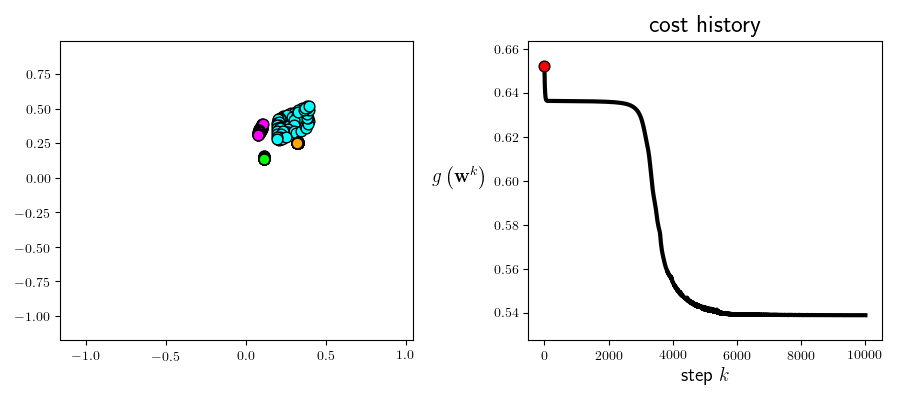
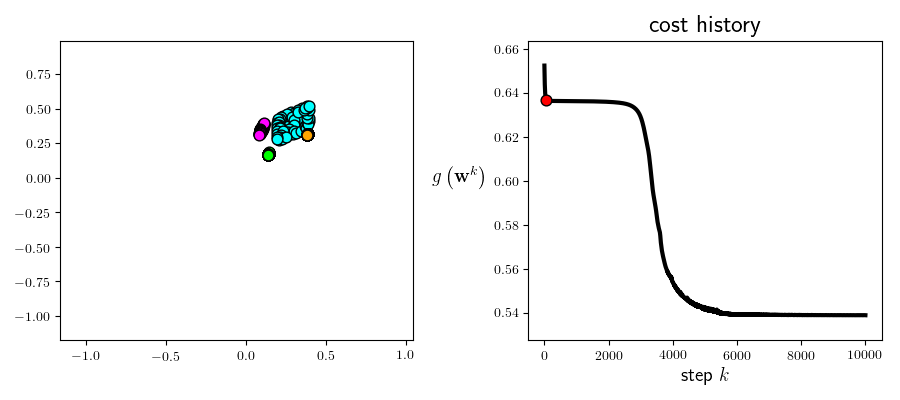
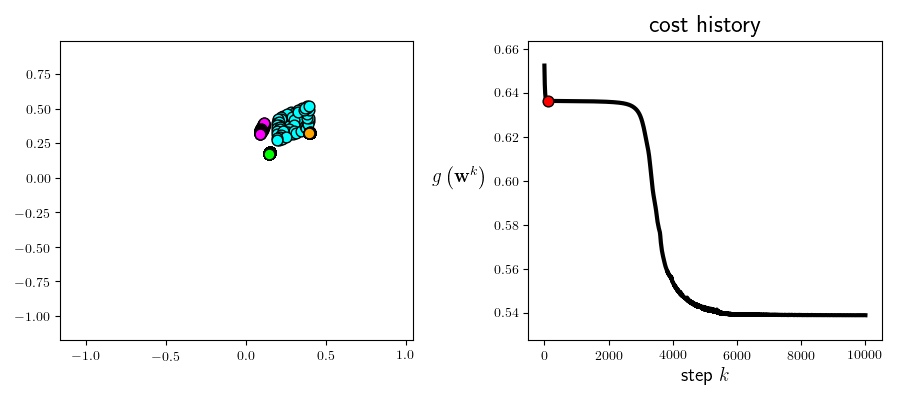
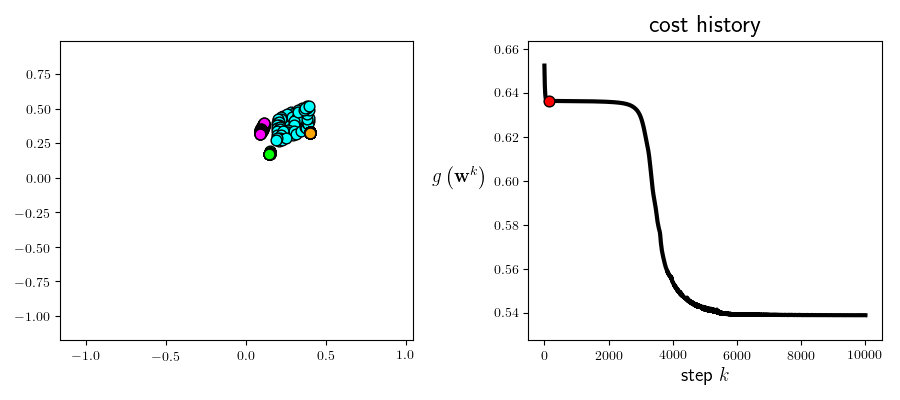
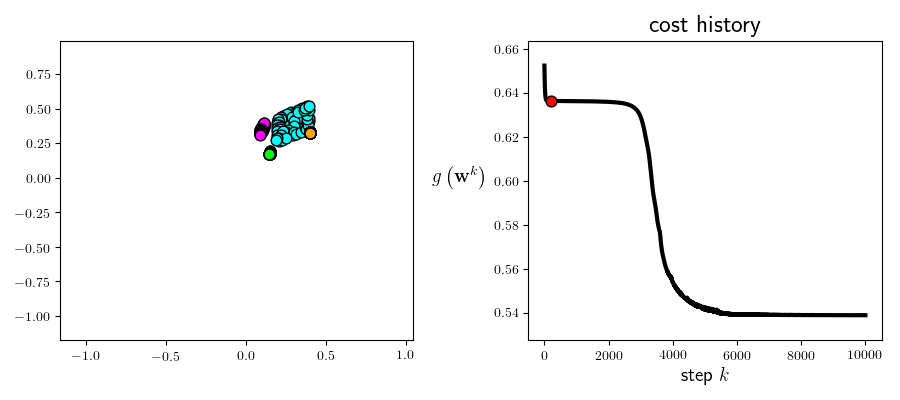
...
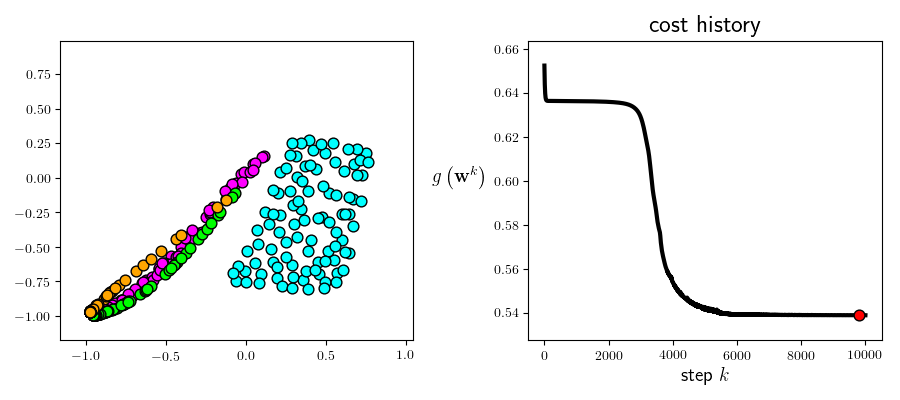
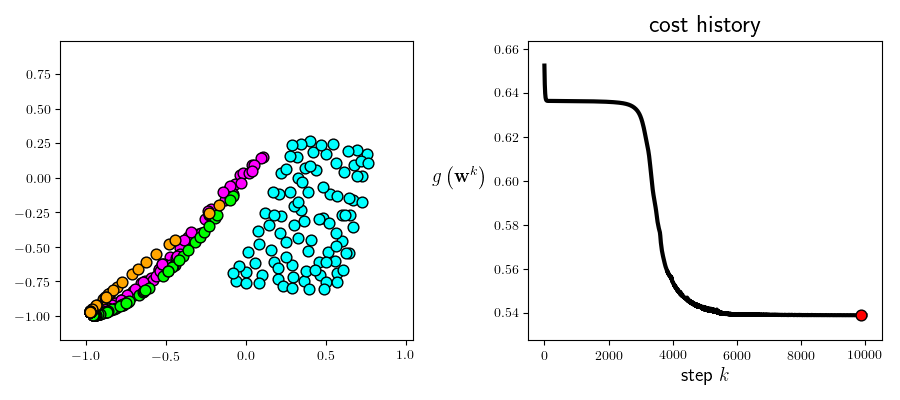
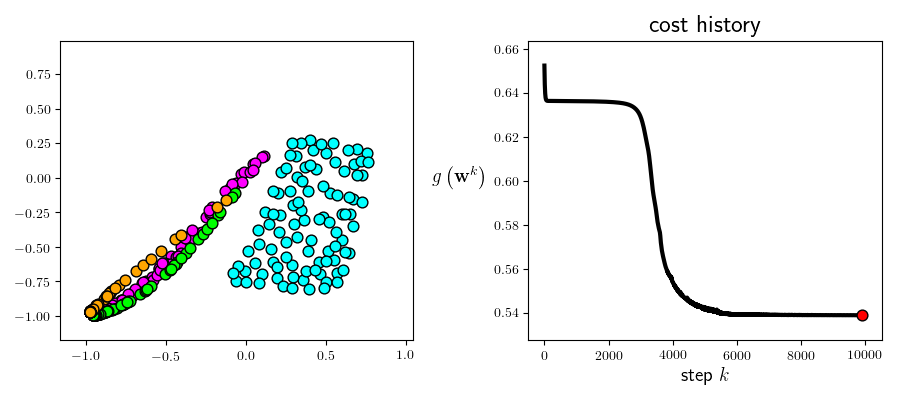
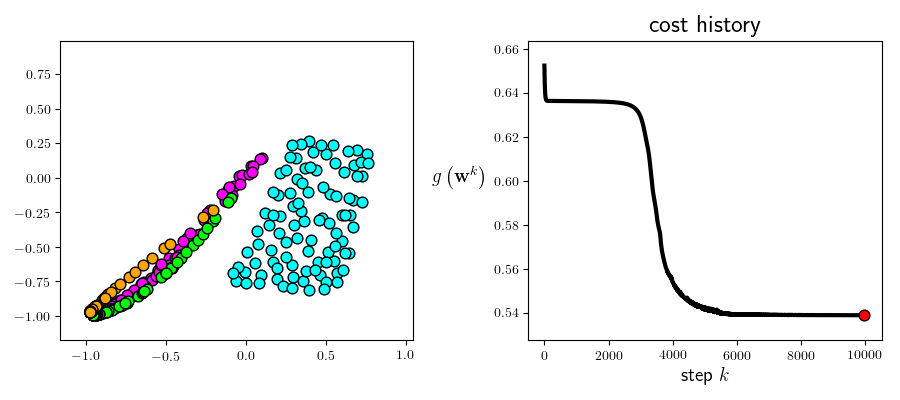
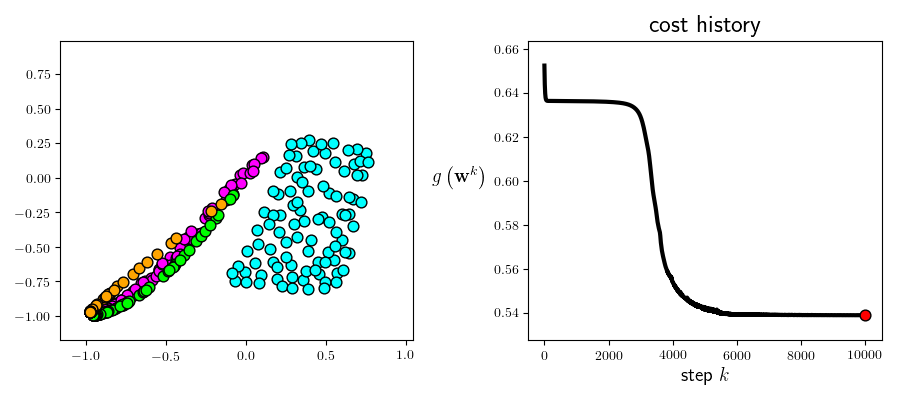

In [412]:
# This code cell will not be shown in the HTML version of this notebook
# show a plot of the distribution of each feature
frames = 200
demo3 = feature_plotter.Visualizer()
demo3.shifting_distribution(run3,frames,x,show_history = True)

Performing batch normalization on each layer of this network helps considerably in taming this covariate shift.  Below we run the same experiment, using the same initialization, activation, and dataset using the batch normalized version of the network.  Afterwards we again animate the covariate shift for a subset of the steps of gradient descent.

In [413]:
# This code cell will not be shown in the HTML version of this notebook
# run gradient descent to minimize a batch normalized multilayer perceptron model
alpha_choice = 10**(-1); max_its = 10000;
run4 = nonlib.basic_runner.Setup(x,y,feature_transforms_batch_normalized,'softmax',normalize = 'standard')
run4.fit(w=w,alpha_choice = alpha_choice,max_its=max_its)

Moving the slider from left to right below progresses the animation from the start to finish of the run.  Scanning over the entire range of steps we can see in the left panel that the distribution of each layer's activation outputs remains much more stable than previously.


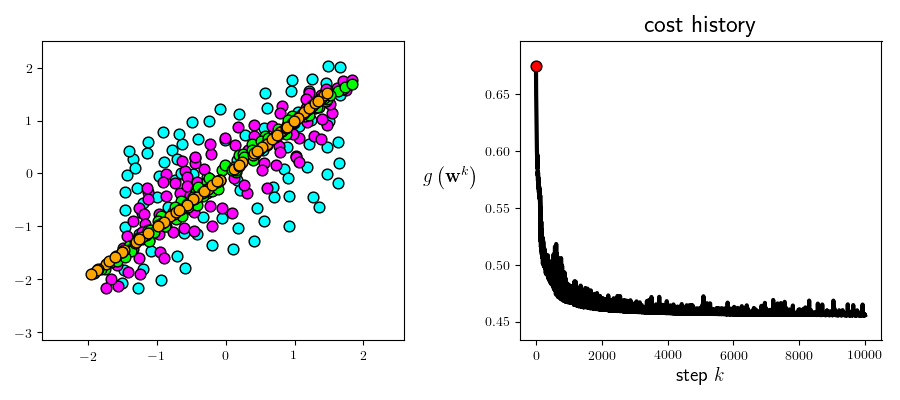
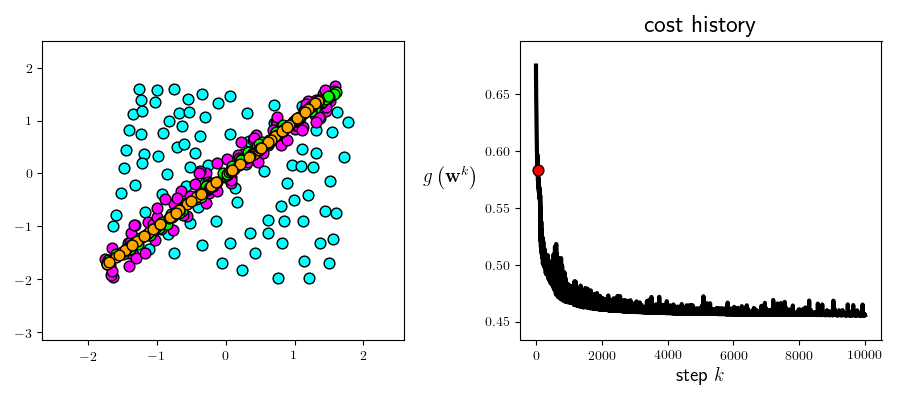
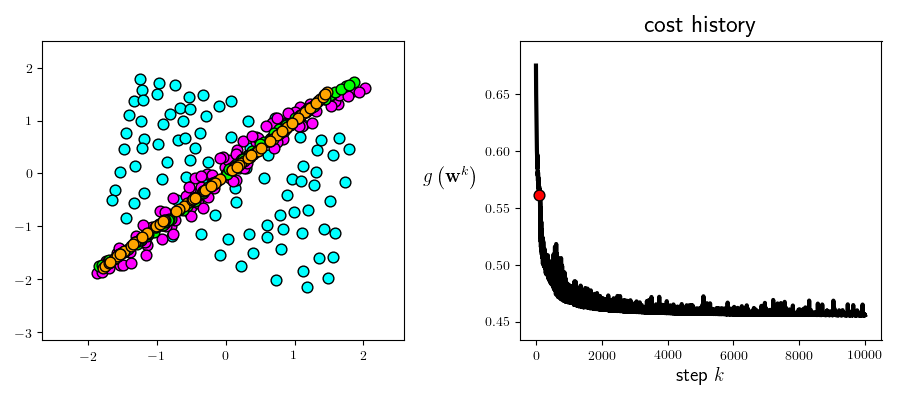
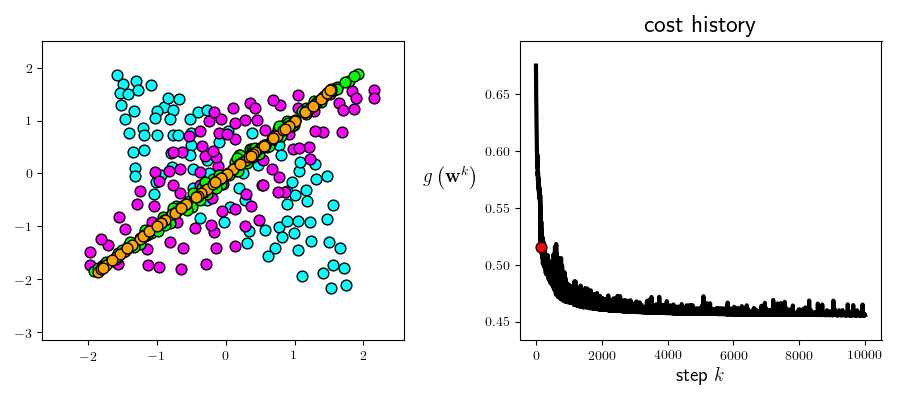
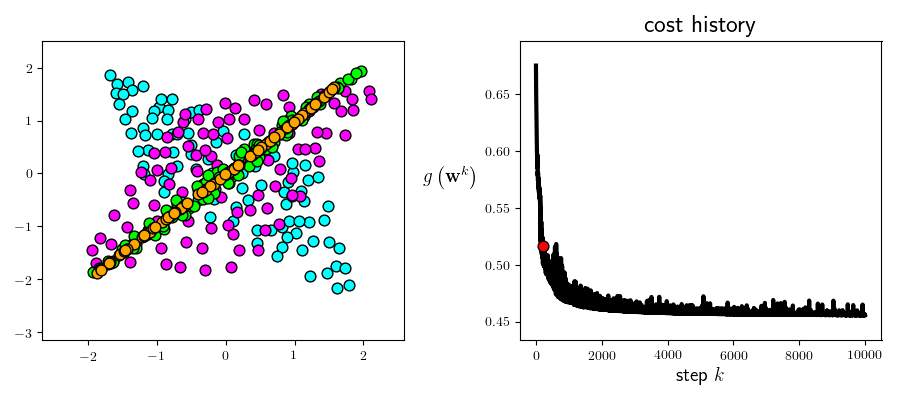
...
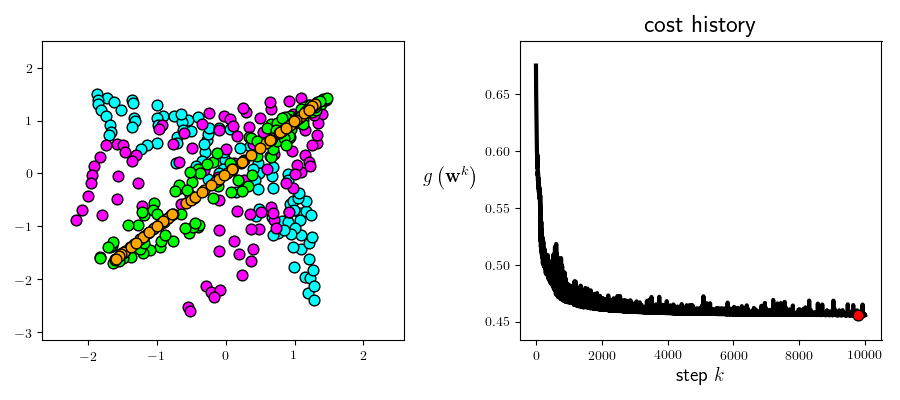
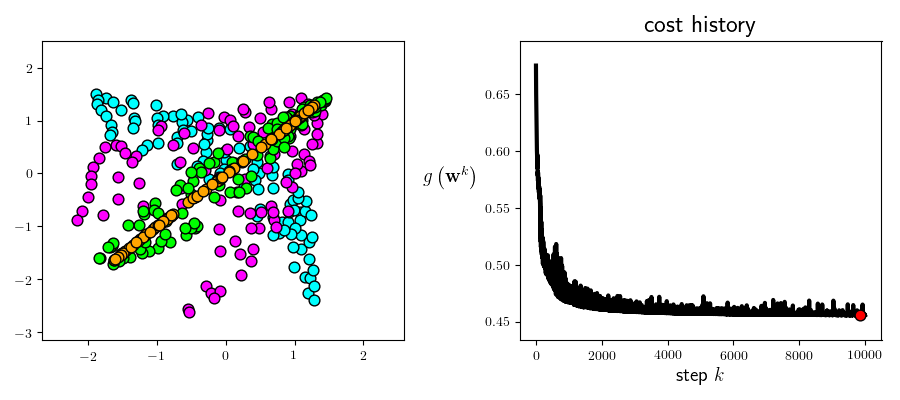
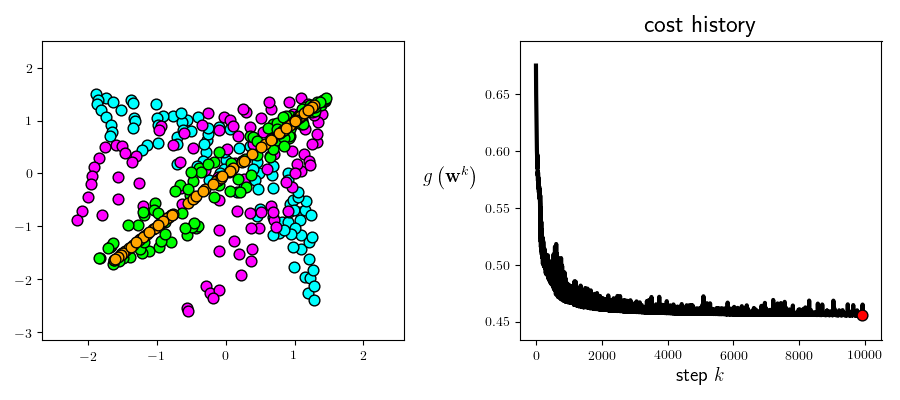
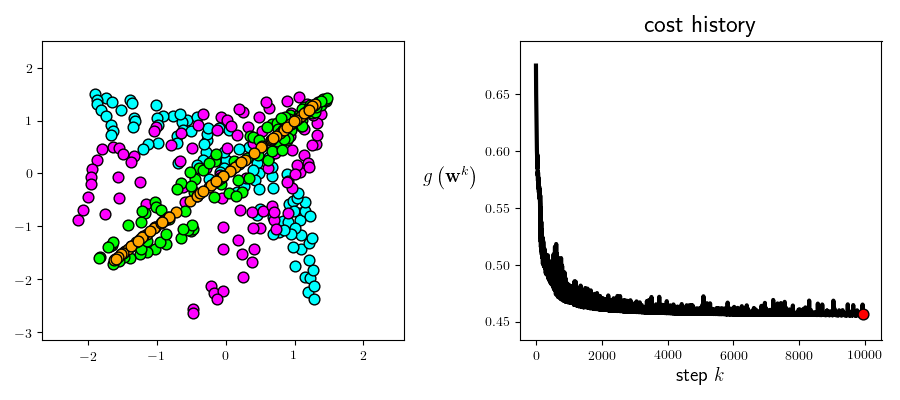
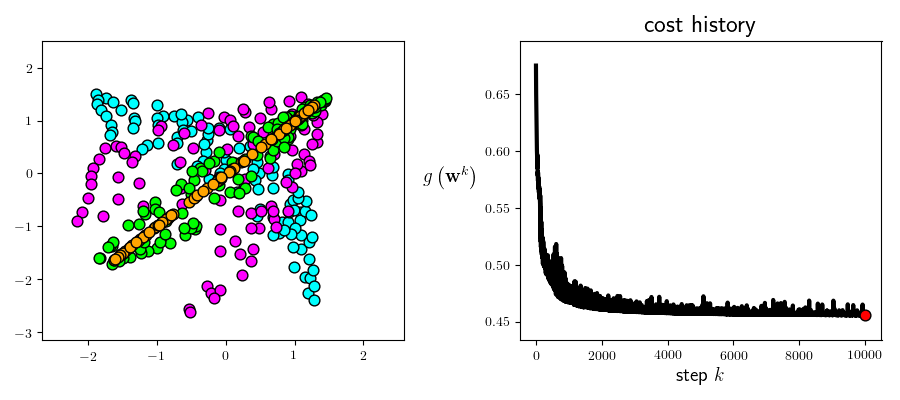

In [415]:
# This code cell will not be shown in the HTML version of this notebook
# show a plot of the distribution of each feature
frames = 200
demo4 = feature_plotter.Visualizer()
demo4.shifting_distribution(run4,frames,x,show_history = True,normalize = True)

#### <span style="color:#a50e3e;">Example 3. </span>  The shifting distributions / internal covariate shift of a multilayer perceptron

In this example we illustrate the benefit of batch normalization in terms of speeding up optimization via graident descent on a dataset of $10,000$ handwritten digits from the MNIST dataset.  Each image in this dataset has been *contrast normalized*, a common preprocessing step for image dataset we discuss later in the context of convolutional networks.  Here we show $1000$ steps of gradient descent, with the largest steplength of the form $10^{-\gamma}$ for integer $\gamma$ we found produced adequate convergence, comparing the standard to batch normalized versions of a network with `relu` activation and a three layer architecture with 10 units per layer.  Here we can see that both in terms of cost function value and number of misclassifications the batch normalized version of the perceptron allows for much more rapid minimization via gradient descent than the original version. 

<IPython.core.display.Javascript object>


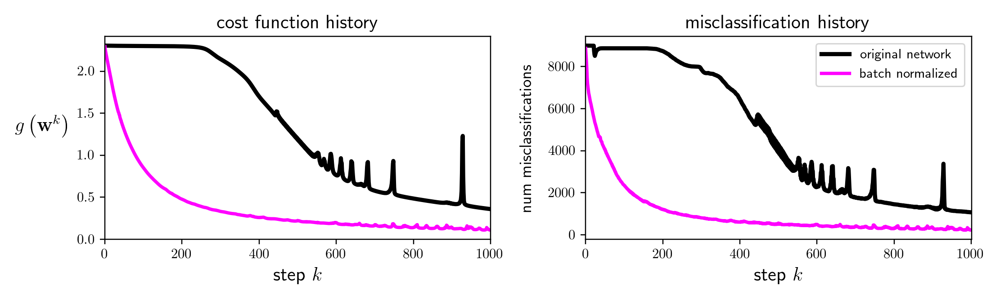

In [303]:
# This code cell will not be shown in the HTML version of this notebook
# load in mnist test set
csvname = '/Users/Nurgetson/Desktop/mnist/mnist_test_contrast_normalized.csv'
data = np.loadtxt(csvname,delimiter = ',')

# get input/output pairs
x = data[:-1,:]
y = data[-1:,:] 

### run gradient descent to minimize a multilayer perceptron model ###
alpha_choice = 10**(-1); max_its = 1000;
w = nonlib.initializers.initialize_network_weights(layer_sizes = [784,10,10,10,10,10],scale = 0.1)

run5 = nonlib.basic_runner.Setup(x,y,feature_transforms,'multiclass_softmax',normalize = 'standard')
run5.fit(w=w,alpha_choice = alpha_choice,max_its=max_its)
count_history_1 = [run5.multiclass_counting_cost(v) for v in run5.weight_history]

### run gradient descent to minimize a batch normalized multilayer perceptron model  ###
alpha_choice = 10**(-1); max_its = 1000;
run6 = nonlib.basic_runner.Setup(x,y,feature_transforms_batch_normalized,'multiclass_softmax',normalize = 'standard')
run6.fit(w=w,alpha_choice = alpha_choice,max_its=max_its)
count_history_2 = [run6.multiclass_counting_cost(v) for v in run6.weight_history]

# plot the cost function history for a given run
classification_plotter.plot_cost_histories([run5.cost_history,run6.cost_history],[count_history_1,count_history_2],start = 0,labels = ['original network','batch normalized'])

## 13.2.6  Evaluating test points using a batch normalized network

Ann important point to to remember when employing a batch normalized network - which we encountered earlier in e.g., Sections 8.4 and 9.4 when introducing standard normalization of input data - is that we must treat test data precisely as we treat training data.  Here this means that every step of normalization computed on the training data, the various means and standard deviations of the input as well as for each each layer of output activation, must be used in the evaluation of new test points as well.  In other words, all normalization constants in a batch normalized network should be *fixed* to the values computed on the training data (at the best step of gradient descent) when evaluating new test points.

> In order to properly evaluate test points with our normalized architecture they must be normalized with respect to the same network statistics (i.e., the same input and activation output distribution normalizations) used for the training data.